In [1]:
from sklearnex import patch_sklearn
patch_sklearn()

Intel(R) Extension for Scikit-learn* enabled (https://github.com/intel/scikit-learn-intelex)


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

from sklearn.preprocessing import StandardScaler
from scipy import stats
from scipy.spatial import distance
from scipy.cluster.hierarchy import linkage, dendrogram, fcluster
from sklearn.cluster import AgglomerativeClustering
from sklearn.neighbors import kneighbors_graph
import geopandas as gpd
import matplotlib.ticker as mticker
from sklearn import metrics
from scipy.cluster import hierarchy
from scipy.sparse import lil_matrix
import os
from libpysal.weights import KNN
import glob
from shapely.geometry import Point
from pyproj import Transformer
import contextily as ctx
from matplotlib_scalebar.scalebar import ScaleBar
from matplotlib.pyplot import cm
import matplotlib as mpl
from matplotlib.colors import ListedColormap

In [3]:
local_crs = 27700
place = "test_OS"
lat = 55.86421405612109
lng = -4.251846930489373
country = "UK"
crs=4326
radius=1
subset_dist = 10000

In [4]:
local_crs = 27700
place = "Glasgow_OS"
lat = 55.86421405612109
lng = -4.251846930489373
country = "UK"
crs=4326
radius=100

**Import Data**

In [5]:
output_directory = f"../output/{place}"

In [6]:
place

'Glasgow_OS'

In [7]:
import glob
import os
import numpy as np
import re

def extract_number(file_name):
    """ Extract the numerical part from the file name. """
    match = re.search(r'\d+', file_name)
    return int(match.group()) if match else None

file_pattern = os.path.join(f"../output/{place}", "percentile_chunk_*.pq")
file_names = glob.glob(file_pattern)

# Extract numbers from the file names
extracted_numbers = [extract_number(fn) for fn in file_names if extract_number(fn) is not None]

# Find the range of numbers
min_number = min(extracted_numbers)
max_number = max(extracted_numbers)

# Generate a set of all expected numbers
expected_numbers = set(range(min_number, max_number + 1))

# Find the missing numbers
missing_numbers = expected_numbers - set(extracted_numbers)

print("Missing numbers:", sorted(list(missing_numbers)))

Missing numbers: []


In [8]:
# Initialize an empty list to store dataframes
dataframes = []

# Iterate over the generated file names and read each file
for id  in sorted(extracted_numbers):
    file_name = os.path.join(output_directory, f"percentile_chunk_{id}.pq")
    
    if os.path.exists(file_name):
        try:
            df = pd.read_parquet(file_name)
            dataframes.append(df)
            print(f"Successfully read {file_name}")
        except Exception as e:
            print(f"Failed to read {file_name}. Error: {e}")
    else:
        print(f"File not found: {file_name}")

# Concatenate all the dataframes into one
combined_df = pd.concat(dataframes, ignore_index=True)

Successfully read ../output/Glasgow_OS\percentile_chunk_0.pq


Successfully read ../output/Glasgow_OS\percentile_chunk_1.pq
Successfully read ../output/Glasgow_OS\percentile_chunk_2.pq
Successfully read ../output/Glasgow_OS\percentile_chunk_3.pq
Successfully read ../output/Glasgow_OS\percentile_chunk_4.pq
Successfully read ../output/Glasgow_OS\percentile_chunk_5.pq
Successfully read ../output/Glasgow_OS\percentile_chunk_6.pq
Successfully read ../output/Glasgow_OS\percentile_chunk_7.pq
Successfully read ../output/Glasgow_OS\percentile_chunk_8.pq
Successfully read ../output/Glasgow_OS\percentile_chunk_9.pq
Successfully read ../output/Glasgow_OS\percentile_chunk_10.pq
Successfully read ../output/Glasgow_OS\percentile_chunk_11.pq
Successfully read ../output/Glasgow_OS\percentile_chunk_12.pq
Successfully read ../output/Glasgow_OS\percentile_chunk_13.pq
Successfully read ../output/Glasgow_OS\percentile_chunk_14.pq
Successfully read ../output/Glasgow_OS\percentile_chunk_15.pq
Successfully read ../output/Glasgow_OS\percentile_chunk_16.pq
Successfully read

In [9]:
combined_df

,height_median,height_IQR,height_25_75_mean,height_10_90_Theil,buildings_neighbours_200_median,buildings_neighbours_200_IQR,buildings_neighbours_200_25_75_mean,buildings_neighbours_200_10_90_Theil,building_area_median,building_area_IQR,...,tess_orientation_weight_25_75_mean,tess_orientation_weight_10_90_Theil,building_neighbourhood_interbuilding_distance_weight_y_median,building_neighbourhood_interbuilding_distance_weight_y_IQR,building_neighbourhood_interbuilding_distance_weight_y_25_75_mean,building_neighbourhood_interbuilding_distance_weight_y_10_90_Theil,bID_y_median,bID_y_IQR,bID_y_25_75_mean,bID_y_10_90_Theil
0,4.30,2.750,4.130769,0.052081,0.442131,0.503672,0.452540,0.119572,32.648465,82.488262,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,8.55,5.400,8.358333,0.056645,9.502397,4.482163,9.695218,0.018368,55.645001,28.356214,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,8.70,3.750,8.582353,0.040751,9.816282,4.163383,9.924251,0.029951,55.645001,34.440606,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,7.90,1.500,7.946667,0.004676,8.731097,4.757299,9.671782,0.036330,74.044998,57.645000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,5.75,2.950,5.466667,0.046758,0.161501,0.220663,0.178799,0.171855,39.790002,73.062287,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
828532,5.30,2.250,5.200000,0.029827,0.176717,0.279615,0.214310,0.210546,53.358500,84.301000,...,19.031560,0.005645,225.431990,22.159721,222.570672,0.001402,10807.0,0.0,10807.000000,5.001020e-07
828533,4.75,2.800,4.672222,0.037500,0.198076,0.358077,0.221376,0.257890,63.945509,145.392488,...,21.054688,0.006935,293.288812,40.901944,297.614606,0.001983,10585.0,0.0,10585.000000,0.000000e+00
828534,4.55,1.725,4.457143,0.031882,2.193536,2.117940,2.452527,0.082238,62.160365,96.799273,...,22.900346,0.017917,74.586818,36.209390,74.844038,0.046849,10807.0,0.0,10807.000000,8.076223e-04
828535,2.10,1.000,1.990909,0.025192,5.810322,0.340817,5.849347,0.000323,12.797999,0.776500,...,37.326788,0.015463,97.522526,42.012541,96.676614,0.023050,10806.0,0.0,10806.000000,0.000000e+00


**Impute missing data with mean**

In [10]:
tess = gpd.read_parquet(f"../output/{place}/tessellation_morphometric_p3.pq")
building = gpd.read_parquet(f"../output/{place}/buildings_morphometric_p3.pq")

In [11]:
combined_df["geometry"] = tess["geometry"]
combined_gdf = gpd.GeoDataFrame(combined_df)

C:\Users\reube\AppData\Local\Temp\ipykernel_21084\2487816440.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  combined_df["geometry"] = tess["geometry"]


In [12]:
transformer = Transformer.from_crs("EPSG:4326", local_crs, always_xy=True)  # Transformer from WGS84 to local CRS
transformed_point = Point(transformer.transform(lng, lat))

# Step 2 & 3: Filter rows where the centroid is within 2km of the latlng
def is_within_2km(geometry):
    centroid = geometry.centroid
    distance = centroid.distance(transformed_point)
    return distance <= subset_dist  # 2km in meters

subset_gdf = combined_gdf[combined_gdf.geometry.apply(is_within_2km)]

In [13]:
buildings = building[building.geometry.apply(is_within_2km)]

In [14]:
combined_df = subset_gdf.drop(columns="geometry")
tess = subset_gdf[["geometry"]]

In [15]:
tess

,geometry
31959,"POLYGON ((249503.305 665925.094, 249502.605 66..."
31960,"POLYGON ((249161.237 665574.612, 249161.660 66..."
31961,"POLYGON ((249724.990 665221.331, 249724.880 66..."
31962,"POLYGON ((249406.011 665271.322, 249405.548 66..."
31963,"POLYGON ((249479.558 665459.844, 249479.601 66..."
...,...
603855,"MULTIPOLYGON (((260121.334 671421.546, 260120...."
603856,"POLYGON ((260770.415 671121.392, 260769.913 67..."
603857,"POLYGON ((262829.026 670608.073, 262828.622 67..."
603858,"POLYGON ((261539.374 671223.125, 261538.956 67..."


In [16]:
# Strings to look for in the column names
strings_to_remove = ["bID", "node_start", "node_end", "profile", "edgeID", "mm_len"]

# Find columns that contain any of the strings to remove
columns_to_drop = [column for column in df.columns if any(substring in column for substring in strings_to_remove)]

# Drop these columns
df = df.drop(columns=columns_to_drop)

c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\seaborn\utils.py:61: UserWarning: Glyph 9 (	) missing from current font.
  fig.canvas.draw()


<Axes: >

C:\Users\reube\AppData\Roaming\Python\Python311\site-packages\IPython\core\events.py:82: UserWarning: Glyph 9 (	) missing from current font.
  func(*args, **kwargs)
C:\Users\reube\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 9 (	) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


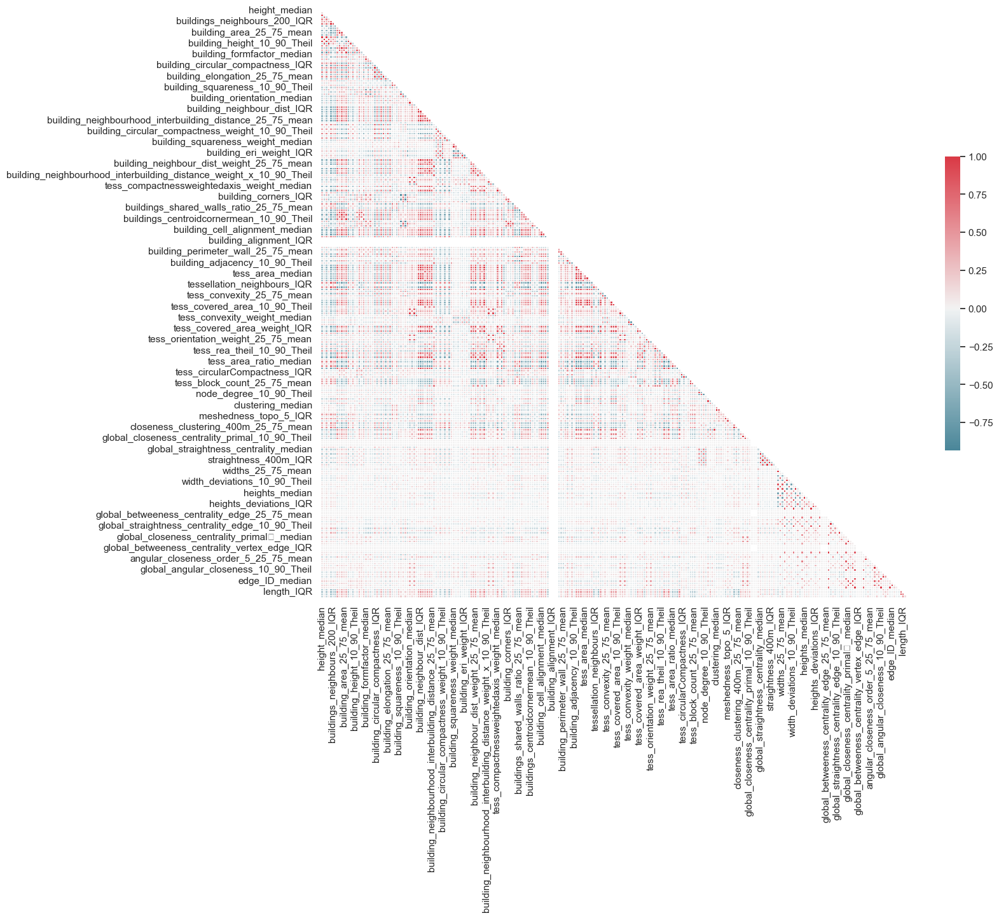

In [17]:
sns.set(style = "white")
cor_matrix = df.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(cor_matrix, dtype = np.bool_))

plt.figure(figsize = (15, 12))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap = True)

sns.heatmap(cor_matrix, mask = mask, cmap = cmap, center = 0,
            square = True, linewidths = .5, cbar_kws = {"shrink": .5})

## Data Preprocessing

**Dealing with outliers**

The Z-score is the signed number of standard deviations by which the value of an observation or data point is above the mean value of what is being observed or measured.

In [18]:
# Compute Z-score for every variable
#z = np.abs(stats.zscore(df))

# Remove outliers from dataset
#df_rem = df[(z < 3).all(axis=1)]
#df_rem

Or simply take the log of right-skewed variables to ensure good clustering results.

**Standardize data**

In [19]:
df = combined_df

In [20]:
df = df.fillna(0)

In [21]:
# Standardise the contextual characters
cont_std = StandardScaler().fit_transform(df)
cont_std = pd.DataFrame(cont_std, columns=df.columns)

c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\utils\extmath.py:1069: RuntimeWarning: overflow encountered in square
  temp **= 2
c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\utils\extmath.py:1075: RuntimeWarning: overflow encountered in square
  new_unnormalized_variance -= correction**2 / new_sample_count
c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\utils\extmath.py:1075: RuntimeWarning: invalid value encountered in subtract
  new_unnormalized_variance -= correction**2 / new_sample_count
c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\preprocessing\_data.py:83: RuntimeWarning: overflow encountered in square
  upper_bound = n_samples * eps * var + (n_samples * mean * eps) ** 2


In [22]:
cont_std = cont_std.fillna(0)

In [23]:
tess = tess[["geometry"]]

In [24]:
cont_std

,height_median,height_IQR,height_25_75_mean,height_10_90_Theil,buildings_neighbours_200_median,buildings_neighbours_200_IQR,buildings_neighbours_200_25_75_mean,buildings_neighbours_200_10_90_Theil,building_area_median,building_area_IQR,...,tess_orientation_weight_25_75_mean,tess_orientation_weight_10_90_Theil,building_neighbourhood_interbuilding_distance_weight_y_median,building_neighbourhood_interbuilding_distance_weight_y_IQR,building_neighbourhood_interbuilding_distance_weight_y_25_75_mean,building_neighbourhood_interbuilding_distance_weight_y_10_90_Theil,bID_y_median,bID_y_IQR,bID_y_25_75_mean,bID_y_10_90_Theil
0,-0.947899,0.493169,-0.858055,1.213324,0.498733,0.178811,0.679771,-0.596978,-0.301718,-0.226530,...,-1.908574,-0.526838,-0.624427,-0.342212,-0.637792,-0.367334,-1.860485,-0.278684,-1.866415,-0.167119
1,0.541623,-0.635989,0.473213,-1.001284,-0.935037,-0.981944,-1.027404,-0.779542,0.675261,-0.392232,...,-1.908574,-0.526838,-0.624427,-0.342212,-0.637792,-0.367334,-1.860485,-0.278684,-1.866415,-0.167119
2,-0.281534,-1.167358,-0.224333,-1.096572,-0.209973,-0.836332,-0.314970,-0.969168,-0.462945,-0.444199,...,-1.908574,-0.526838,-0.624427,-0.342212,-0.637792,-0.367334,-1.860485,-0.278684,-1.866415,-0.167119
3,-0.281534,-1.134147,-0.218081,-1.122382,0.260660,-0.553872,0.167730,-0.896857,-0.533548,-0.440399,...,-1.908574,-0.526838,-0.624427,-0.342212,-0.637792,-0.367334,-1.860485,-0.278684,-1.866415,-0.167119
4,-0.163940,-1.242081,-0.115197,-1.136626,0.234969,-0.957664,0.156485,-1.034825,-0.545135,-0.493227,...,-1.908574,-0.526838,-0.624427,-0.342212,-0.637792,-0.367334,-1.860485,-0.278684,-1.866415,-0.167119
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
342020,-0.673513,-0.187647,-0.751558,-0.193025,-1.349863,-0.268698,-1.416861,4.439340,0.136860,0.074672,...,0.569080,-0.200335,3.108891,2.328521,3.299965,0.095659,-0.876961,-0.278684,-0.878980,0.932466
342021,-0.438325,0.277301,-0.683199,0.630126,1.517845,1.001873,1.543708,-0.502285,-0.426520,-0.169866,...,-0.062975,-0.216366,-0.312359,-0.322432,-0.320786,-0.362641,1.512042,-0.246001,1.520792,-0.167105
342022,-0.516721,-0.270673,-0.523571,-0.399448,0.022621,-0.224591,-0.125144,-0.592928,-0.769401,-0.279503,...,-0.169217,-0.295677,-0.069878,-0.234016,-0.074912,-0.334014,1.489752,-0.278684,1.497144,-0.167119
342023,-0.320732,0.260696,-0.493699,0.656487,-0.035649,0.899663,0.209957,0.756278,-0.459791,0.020182,...,0.835214,-0.485209,-0.063604,-0.296741,-0.070448,-0.357417,1.501092,-0.278684,1.508530,-0.167117


In [25]:
# Build spatial matrix. We tried different methods and KNN seems the best so far.
n=3
w = KNN.from_dataframe(tess, k=n)

c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 179 disconnected components.
  warnings.warn(message)


In [26]:
# Test different number of clusters/urban types (between 2 and 11)
cont_std_ = cont_std.copy()
K = range(15,25) 
s = {}
db = {}

In [27]:
w.sparse

<342025x342025 sparse matrix of type '<class 'numpy.float64'>'
	with 1026075 stored elements in Compressed Sparse Row format>

In [29]:
import time

In [30]:
%%time
for k in K: 
    
    start_time = time.time()  # Start timing
    s[k] = []
    db[k] = []
    np.random.seed(123456) #for reproducibility
    model = AgglomerativeClustering(linkage='ward', connectivity=w.sparse, n_clusters=k)
    y = model.fit(cont_std)
    cont_std_['AHC_k'+ str(k)] = y.labels_
    print('silhouette at k=' + str(k) + ': ' + str(metrics.silhouette_score(cont_std, y.labels_, metric='euclidean')))
    s[k].append(metrics.silhouette_score(cont_std, y.labels_, metric='euclidean'))
    
    davies_bouldin_score = metrics.davies_bouldin_score(cont_std, y.labels_)
    print(f'davies bouldin at k={k}: {davies_bouldin_score}')
    db[k].append(davies_bouldin_score)
    
    end_time = time.time()  # End timing
    print(f"Time for k={k}: {end_time - start_time} seconds")  # Print the duration for the cycle

c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 179 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=15: 0.018213342914607973
davies bouldin at k=15: 3.7793580713722164
Time for k=15: 3560.2637219429016 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 179 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=16: 0.0004501357533389786
davies bouldin at k=16: 4.0344409120410605
Time for k=16: 3506.2582020759583 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 179 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=17: 0.0005123626352209072
davies bouldin at k=17: 4.101213990362712
Time for k=17: 3515.9580879211426 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 179 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=18: 0.00010292169986397202
davies bouldin at k=18: 3.655661294678547
Time for k=18: 3519.478278398514 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 179 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=19: -0.01479155280924594
davies bouldin at k=19: 3.7180478364734846
Time for k=19: 3503.934587240219 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 179 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=20: -0.014293215682195307
davies bouldin at k=20: 3.715326863563361
Time for k=20: 3516.971912622452 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 179 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=21: -0.013684872756922406
davies bouldin at k=21: 3.599414409385097
Time for k=21: 3525.643872976303 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 179 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=22: -0.013192157218502122
davies bouldin at k=22: 3.559427937123701
Time for k=22: 3530.93452000618 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 179 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=23: -0.011869921051039815
davies bouldin at k=23: 3.55150320432825
Time for k=23: 3538.060892343521 seconds


c:\Users\reube\anaconda3\envs\nbprocessor\Lib\site-packages\sklearn\cluster\_agglomerative.py:304: UserWarning: the number of connected components of the connectivity matrix is 179 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


silhouette at k=24: -0.018501708820167842
davies bouldin at k=24: 3.7049146082829174
Time for k=24: 3532.563378572464 seconds
CPU times: total: 1d 3h 8min 45s
Wall time: 9h 47min 30s


In [50]:
# Create the silhouette diagram  
vals_s = []
clus_s = []

for c, v in s.items():
    vals_s += v
    clus_s += [c]

In [51]:
s.items()

dict_items([(15, [0.018213342914607973]), (16, [0.0004501357533389786]), (17, [0.0005123626352209072]), (18, [0.00010292169986397202]), (19, [-0.01479155280924594]), (20, [-0.014293215682195307]), (21, [-0.013684872756922406]), (22, [-0.013192157218502122]), (23, [-0.011869921051039815]), (24, [-0.018501708820167842])])

In [52]:
# Create the silhouette diagram  
vals_db = []
clus_db = []

for c, v in db.items():
    vals_db += v
    clus_db += [c]

In [53]:
cont_std_["geometry"] = subset_gdf.reset_index()["geometry"]

In [54]:
cont_std_["geometry"]

0         POLYGON ((249503.305 665925.094, 249502.605 66...
1         POLYGON ((249161.237 665574.612, 249161.660 66...
2         POLYGON ((249724.990 665221.331, 249724.880 66...
3         POLYGON ((249406.011 665271.322, 249405.548 66...
4         POLYGON ((249479.558 665459.844, 249479.601 66...
                                ...                        
342020    MULTIPOLYGON (((260121.334 671421.546, 260120....
342021    POLYGON ((260770.415 671121.392, 260769.913 67...
342022    POLYGON ((262829.026 670608.073, 262828.622 67...
342023    POLYGON ((261539.374 671223.125, 261538.956 67...
342024    POLYGON ((264845.095 672329.106, 264844.517 67...
Name: geometry, Length: 342025, dtype: geometry

In [70]:
out_gdf = gpd.GeoDataFrame(cont_std_, geometry="geometry")

In [71]:
out_gdf.to_parquet(f"../output/{place}/cont_std_{subset_dist}.pq")

In [72]:
silhouettes = pd.DataFrame({'n_cluster': clus_s, 'silhouette': vals_s})

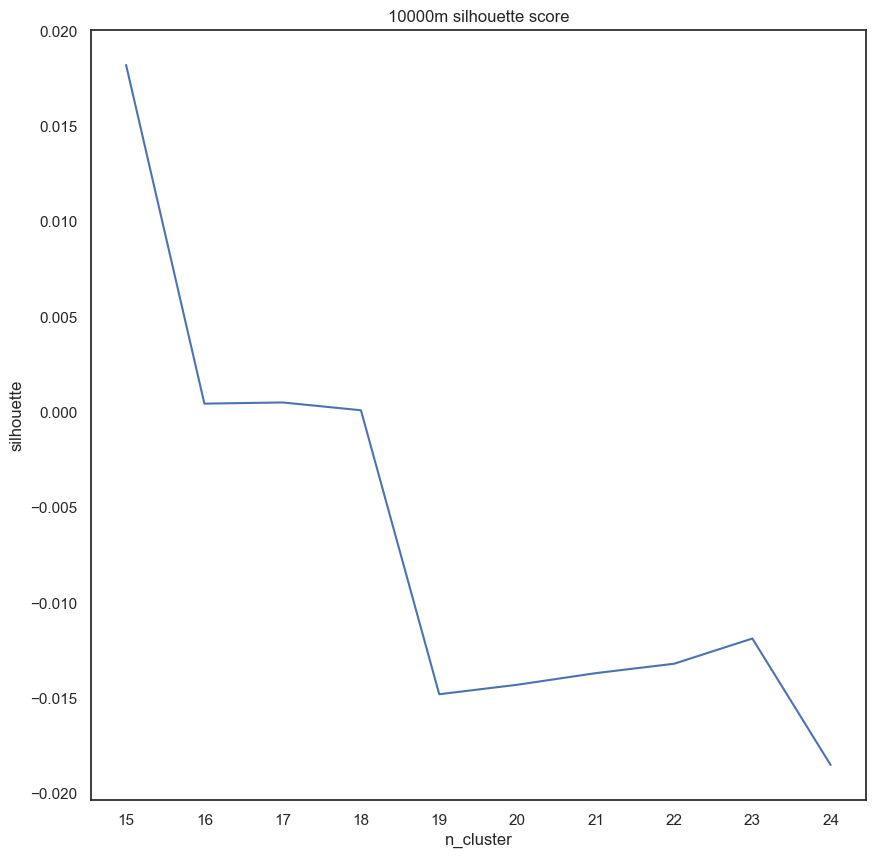

In [73]:
# Plot the silhouette diagram. The best solution is usually a peak before a sudden drop. We would go with 6 in this case.
fig, ax = plt.subplots(figsize=(10, 10))
sns.lineplot(x="n_cluster", y="silhouette", data=silhouettes)
plt.ticklabel_format(style='plain')
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(1))
plt.title(f"{subset_dist}m silhouette score")
plt.savefig(f"../output/{place}/{subset_dist}msilhouette.jpg")
plt.show()

In [74]:
davies_bouldin = pd.DataFrame({'n_cluster': clus_db, 'davies_bouldin': vals_db})

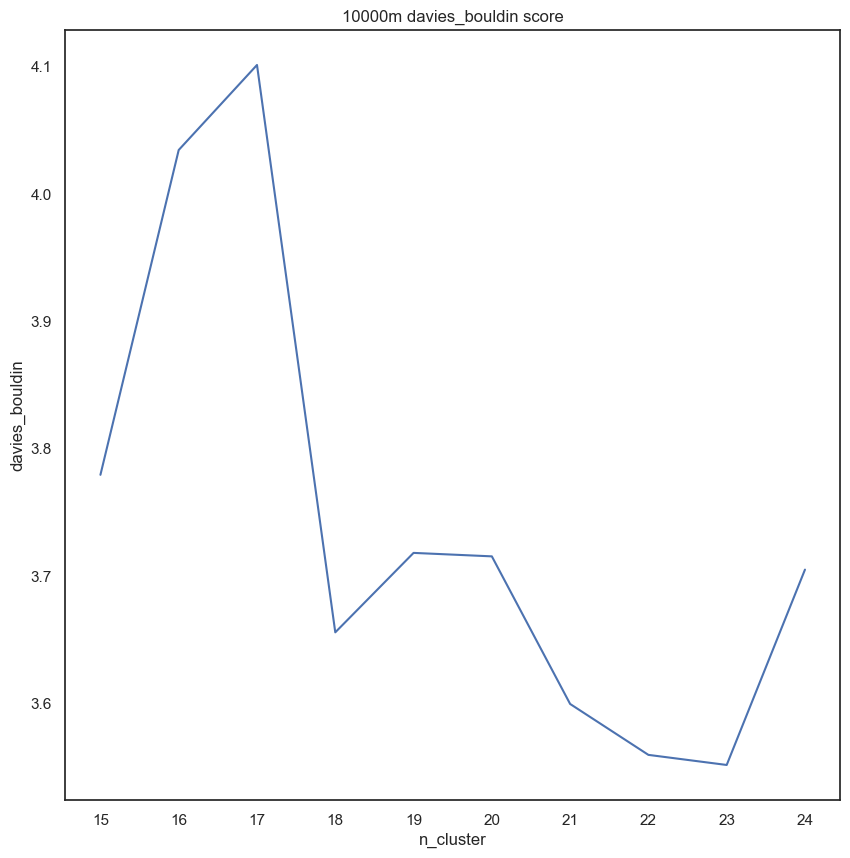

In [75]:
# Plot the silhouette diagram. The best solution is usually a peak before a sudden drop. We would go with 6 in this case.
fig, ax = plt.subplots(figsize=(10, 10))
sns.lineplot(x="n_cluster", y="davies_bouldin", data=davies_bouldin)
plt.ticklabel_format(style='plain')
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(1))
plt.title(f"{subset_dist}m davies_bouldin score")
plt.savefig(f"../output/{place}/{subset_dist}mdavies_bouldin.jpg")
plt.show()

In [76]:

n = 18 # Specify the number of colors you need

In [77]:
import seaborn as sns

# Function to generate a qualitative color palette
def generate_qualitative_palette(n_colors):
    palette = palette = sns.color_palette("Spectral", n_colors=n_colors)
    return palette

# Example usage
qualitative_palette = generate_qualitative_palette(n)

palette_dict = {}
# Printing the palette
for i, color in enumerate(qualitative_palette):
    palette_dict[i] = color
    
qualitative_palette

[(0.7295655517108804, 0.12587466359092656, 0.2848135332564398),
 (0.8376778162245291, 0.2467512495194156, 0.308881199538639),
 (0.9044213763936948, 0.34794309880815066, 0.28304498269896194),
 (0.9596309111880047, 0.44744329104190683, 0.2719723183391003),
 (0.9790080738177624, 0.5873894655901576, 0.3365628604382929),
 (0.9926951172625913, 0.7092656670511341, 0.40299884659746243),
 (0.9948481353325644, 0.8169165705497885, 0.4934256055363321),
 (0.9968473663975395, 0.9022683583237217, 0.5850826605151864),
 (0.9990003844675125, 0.9690119184928874, 0.697039600153787),
 (0.9750096116878124, 0.9900038446751249, 0.7100346020761246),
 (0.9211841599384853, 0.9684736639753941, 0.6260668973471745),
 (0.8293733179546331, 0.9312572087658594, 0.6108419838523644),
 (0.7023452518262209, 0.8795847750865053, 0.6366782006920415),
 (0.5697808535178779, 0.8272202998846598, 0.6445982314494426),
 (0.42122260668973477, 0.7690888119953864, 0.6467512495194156),
 (0.31203383314109956, 0.6626682045367166, 0.6876585928489043),
 (0.20007689350249905, 0.5377931564782776, 0.7393310265282584),
 (0.2806612841214917, 0.423760092272203, 0.6892733564013841)]

In [78]:
palette_dict

{0: (0.7295655517108804, 0.12587466359092656, 0.2848135332564398),
 1: (0.8376778162245291, 0.2467512495194156, 0.308881199538639),
 2: (0.9044213763936948, 0.34794309880815066, 0.28304498269896194),
 3: (0.9596309111880047, 0.44744329104190683, 0.2719723183391003),
 4: (0.9790080738177624, 0.5873894655901576, 0.3365628604382929),
 5: (0.9926951172625913, 0.7092656670511341, 0.40299884659746243),
 6: (0.9948481353325644, 0.8169165705497885, 0.4934256055363321),
 7: (0.9968473663975395, 0.9022683583237217, 0.5850826605151864),
 8: (0.9990003844675125, 0.9690119184928874, 0.697039600153787),
 9: (0.9750096116878124, 0.9900038446751249, 0.7100346020761246),
 10: (0.9211841599384853, 0.9684736639753941, 0.6260668973471745),
 11: (0.8293733179546331, 0.9312572087658594, 0.6108419838523644),
 12: (0.7023452518262209, 0.8795847750865053, 0.6366782006920415),
 13: (0.5697808535178779, 0.8272202998846598, 0.6445982314494426),
 14: (0.42122260668973477, 0.7690888119953864, 0.6467512495194156),
 

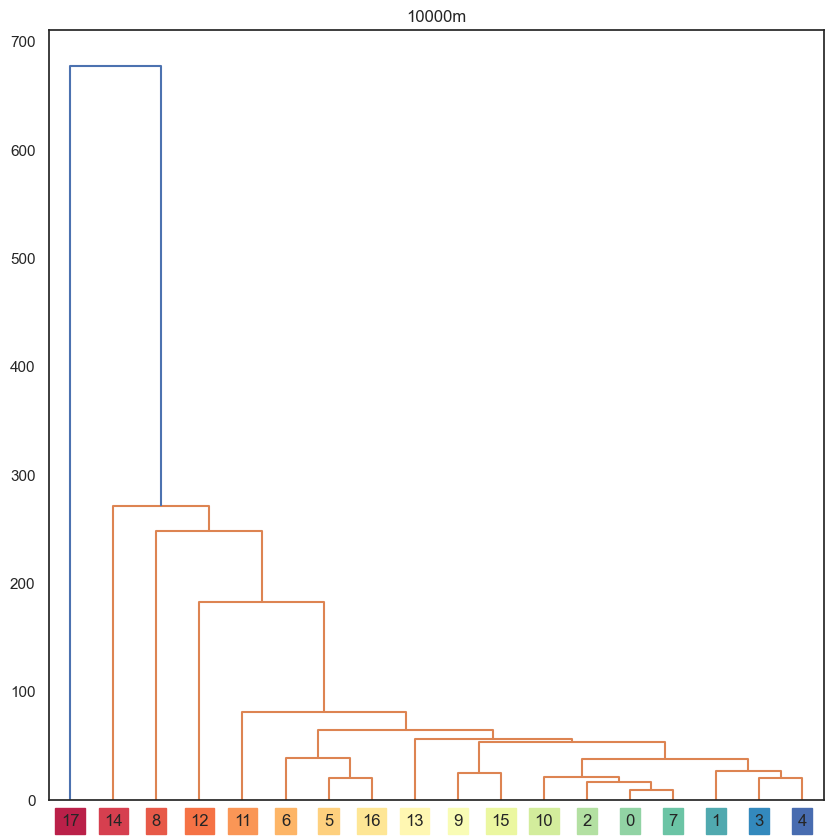

In [79]:
group = out_gdf.drop(columns="geometry").groupby(f'AHC_k{n}').mean()
Z = hierarchy.linkage(group, 'ward')
plt.figure(figsize=(10, 10))
dn = hierarchy.dendrogram(Z, labels=group.index)

plt.title(f"{subset_dist}m")
# Applying the color palette to the dendrogram
ax = plt.gca()
x_labels = ax.get_xmajorticklabels()
for i, x_label in enumerate(x_labels):
    idx = int(x_label.get_text())
    x_label.set_backgroundcolor(palette_dict[i])

plt.savefig(f"../output/{place}/{subset_dist}dendogram.jpg")
plt.show()


In [80]:
mapped_palette_dict = {}
for index, (key, value) in enumerate(palette_dict.items()):
    mapped_palette_dict[dn['leaves'][index]] = palette_dict[key]

In [81]:

# Convert your color dictionary to a list in the correct order
palette = [mapped_palette_dict[i] for i in sorted(mapped_palette_dict)]


In [82]:
# Convert your color dictionary to a list in the correct order
palette = [mapped_palette_dict[i] for i in sorted(mapped_palette_dict)]

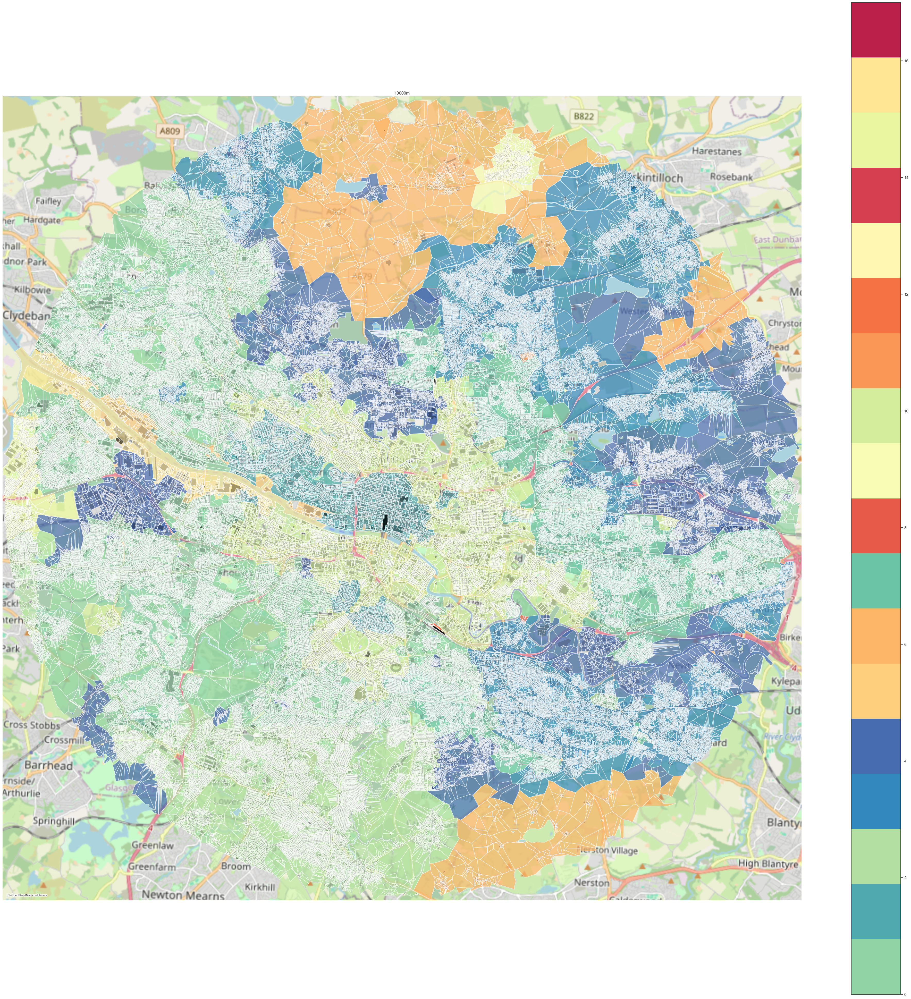

In [83]:
# Create a single subplot
fig, ax = plt.subplots(figsize=(50, 50))  # You can adjust the figure size

# Set the limits to the extent of out_gdf
xmin, ymin, xmax, ymax = out_gdf.total_bounds
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)


plt.title(f"{subset_dist}m")
# Plotting the GeoDataFrame
out_gdf.plot(column=f'AHC_k{n}', ax=ax, cmap=ListedColormap(palette), legend=True, alpha=0.7)

buildings.plot(ax=ax, color='black', edgecolor='none', alpha=0.2)

# Adding a basemap
ctx.add_basemap(ax, crs=out_gdf.crs.to_string(), source=ctx.providers.OpenStreetMap.Mapnik)

# Removing axis
ax.set_axis_off()

plt.savefig(f"../output/{place}/{subset_dist}plot.jpg")

# Display the plot
plt.show()